In [1]:
# Importation des librairies
from netCDF4 import Dataset
import numpy as np
import os as os
from mpl_toolkits.basemap import Basemap
import matplotlib.patheffects as PathEffects
import itertools
from itertools import chain
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
import pylab as p
from scipy.stats import skew, kurtosis
from matplotlib.transforms import Bbox
import sys
sys.path.insert(1, '../ERA')
from ERA_Fields import*

def create_mask(model, area, data):
    """
      This function allow to extract a subset of data encloses in the area.
      The output have the dimension of the area.
      If the area is cutted by the Grinwich meridian, a concatenation is required.
    """
    if model == "CESM":
        if area == "France":
            return np.concatenate((data[-51:-41, -3:],data[-51:-41, :6]), axis=1)
        elif area == "Scandinavia":
            return data[-36:-20, 4:32]
class Model_Field:
    def __init__(self, name, filename, label, Model, lat_start=0, lat_end=241, lon_start=0, lon_end=480):
        self.name = name    # Name inside the .nc file
        self.filename = filename # Name of the .nc file 
        self.label = label  # Label to be displayed on the graph
        self.var = []    
        self.lat_start = lat_start
        self.lat_end = lat_end
        self.lon_start = lon_start
        self.lon_end = lon_end
        self.time_start = time_start
        self.time_end = time_end
        self.Model = Model
    def load_field(self, folder):   # Load the year from the database
        dataset = Dataset(folder+self.filename+'.nc')
        self.time = np.asarray(dataset.variables['time'][:]).reshape(1000,-1)
        if self.name == 'Z3':
            self.var = dataset.variables[self.name][:,0,self.lat_start:self.lat_end,self.lon_start:self.lon_end]
        else:
            self.var = dataset.variables[self.name][:,self.lat_start:self.lat_end,self.lon_start:self.lon_end]
        self.var = np.logical_not(np.ma.getmask(self.var))*np.ma.getdata(self.var) # This statement is needed to set to 0 the points in the ocean that have mask = True
        print("input var.shape = ",self.var.shape)
        self.var = self.var.reshape(1000, self.var.shape[0]//1000, self.var.shape[1], self.var.shape[2])
        self.lon = dataset.variables["lon"][self.lon_start:self.lon_end]
        self.lat = dataset.variables["lat"][self.lat_start:self.lat_end]
        self.LON, self.LAT = np.meshgrid(self.lon, self.lat)
        print("output var.shape = ",self.var.shape)
        print("self.time.shape = ",self.time.shape)
        print(np.max(np.diff(self.time))," < np.diff(self.time) < ",np.min(np.diff(self.time)))
        dataset.close()
        
    def Greenwich(self, year, day):  # Take an array and copy the Greenwhich meridian to make sure we avoid a segment hole in basemap
        return np.append(self.var[year,day,:,:],np.transpose([self.var[year,day,:,0]]),axis = 1)
    
    def Set_area_integral(self, input_area, input_mask):   # Evaluate area integral
        self.abs_mask = np.zeros((self.var.shape[0],self.var.shape[1]))    # integral over the area
        for y in range(self.var.shape[0]):
            for i in range(self.var.shape[1]):
                self.abs_mask[y,i] = np.sum(np.sum(create_mask(self.Model,input_area,self.var[y,i,:,:])*input_mask))
        self.ano_abs_mask = self.abs_mask - np.mean(self.abs_mask,0)    # Evaluate grid-point climatological mean 
        anomaly_series = self.ano_abs_mask.copy()
        series = self.abs_mask.copy()
        return series, anomaly_series
                
Model = 'CESM'
area = 'France'
lon_start = 0
lon_end = 288
lat_start = 192-192*60//180 # latitudes start from 90 degrees North Pole
lat_end = 192


Months1 = [0, 0, 0, 0, 0, 0, 31, 30, 31, 31, 30, 0, 0, 0] # Because of 3 day running mean we lose 2 days
Tot_Mon1 = list(itertools.accumulate(Months1))
time_start = Tot_Mon1[5]
time_end = Tot_Mon1[10]

t2m = Model_Field('TSA','TSA','Temperature', Model,lat_start, lat_end, lon_start, lon_end)
t2m.load_field('Data_CESM/North_Anomalies_')
zg500 = Model_Field('Z3','Z3.500hPa','500 mbar geopotential', Model, lat_start, lat_end, lon_start, lon_end)
zg500.load_field('Data_CESM/North_Anomalies_')
LON = t2m.LON
LAT = t2m.LAT

Trying to import basemap
Successfully imported basemap
input var.shape =  (153000, 64, 288)
output var.shape =  (1000, 153, 64, 288)
self.time.shape =  (1000, 153)
1.0000000000009095  < np.diff(self.time) <  0.9999999999999716
input var.shape =  (153000, 64, 288)
output var.shape =  (1000, 153, 64, 288)
self.time.shape =  (1000, 153)
1.0000000000009095  < np.diff(self.time) <  0.9999999999999716


In [2]:
(Tot_Mon1[9])-(Tot_Mon1[6])

92

/tmp/ipykernel_3937152/1785145279.py:16: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])


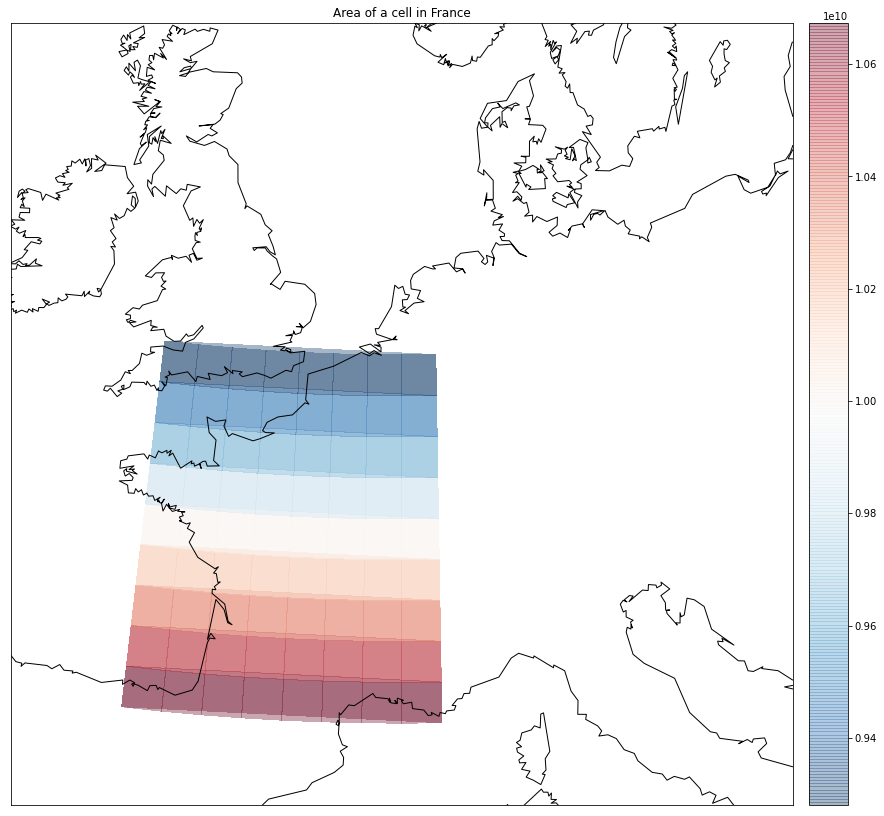

In [3]:
LON_mask = create_mask(Model,area,LON)
LAT_mask = create_mask(Model,area,LAT)
# Load the land area mask
dataset = Dataset('Data_CESM/CAM_landmask.nc')
lsm = dataset.variables['landmask'][lat_start:lat_end,lon_start:lon_end]
dataset.close()
# Load the areas of each cell
dataset = Dataset('Data_CESM/CAM_cellarea.nc')
cell_area = dataset.variables["cell_area"][lat_start:lat_end,lon_start:lon_end]
dataset.close()
mask_ocean = np.array(lsm)
mask_area = np.array(create_mask(Model,area, lsm))

coords = [50, 5., 2000000, 2000000]
fig = plt.figure(figsize=(15, 15), edgecolor='w')
m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])
m.pcolormesh(Greenwich(LON_mask), Greenwich(LAT_mask), Greenwich(create_mask(Model,area,cell_area)), latlon=True, alpha = .35, cmap='RdBu_r')
plt.title("Area of a cell in France")
m.colorbar()
m.drawcoastlines()
plt.show()

/tmp/ipykernel_3937152/1969769661.py:3: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])


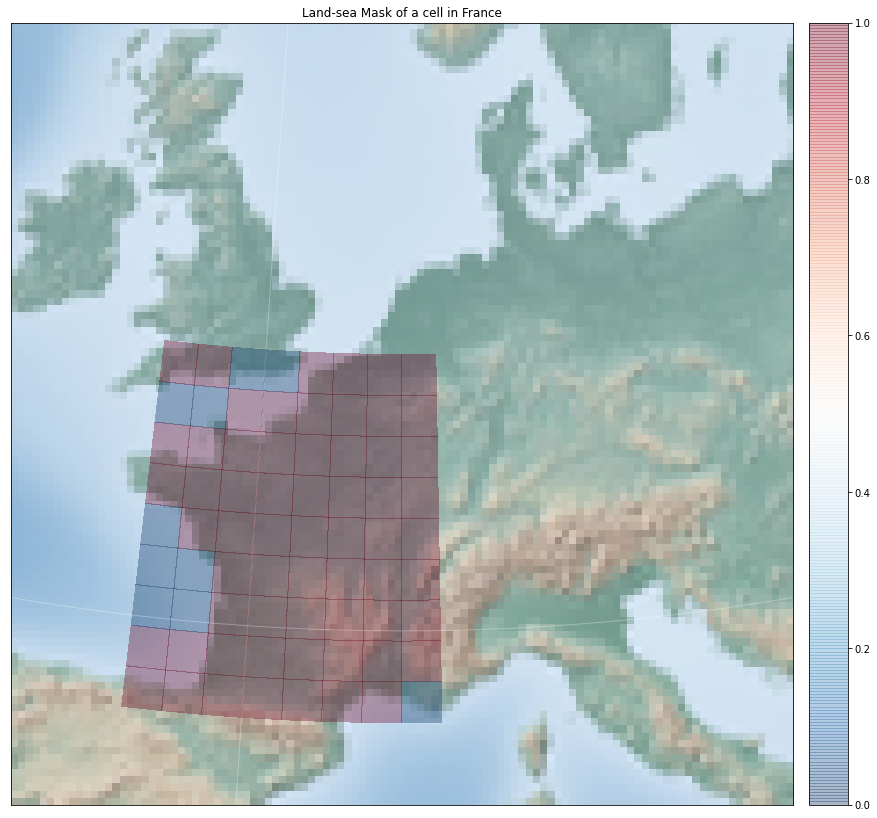

In [4]:
fig = plt.figure(figsize=(15, 15), edgecolor='w')
#m = Basemap(projection='nplaea',boundinglat=25,lon_0=0,resolution='c')
m = Basemap(width=coords[2],height=coords[3],resolution='l',projection='aea',lat_ts=60,lat_0=coords[0],lon_0=coords[1])
draw_map(m)
m.pcolormesh((LON_mask), (LAT_mask), (create_mask(Model,area,lsm)), latlon=True, alpha = .35, cmap='RdBu_r')
plt.title("Land-sea Mask of a cell in France")
m.colorbar()
plt.show()

mylon =  6.25 , mylat =  44.764397 , mylon_coor =  1099055.7615116562 , mylat_coor =  419405.7550394216
0


/tmp/ipykernel_3937152/3446524854.py:20: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')


31
61
92


<Figure size 2880x2880 with 0 Axes>

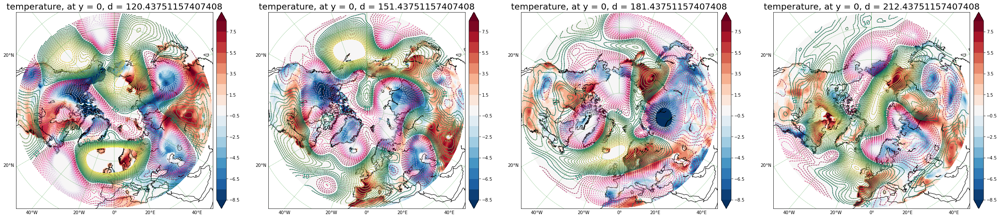

In [5]:
y = 0
mylon_pixel = 5
mylat_pixel = 15
mylon = LON[mylat_pixel, mylon_pixel]
mylat = LAT[mylat_pixel, mylon_pixel]
mylon_coor, mylat_coor = m(mylon, mylat)
print("mylon = ",mylon,", mylat = ",mylat, ", mylon_coor = ",mylon_coor, ", mylat_coor = ", mylat_coor)

t2m.levels = np.linspace(-8.5, 8.5, 18)  # Levels to be used when plotting
zg500.levels = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
fig2 = plt.figure(figsize=(40, 40))
spec2 = gridspec.GridSpec(ncols=4, nrows=1, figure=fig2)
iterate = 0
ax = []
fig2 = plt.figure(figsize=(40, 10))
for i,subplt in zip(Tot_Mon1[5:9],['141','142','143','144']):
    ax.append(fig2.add_subplot(spec2[0,iterate]))
    iterate = iterate + 1
    print(i)
    m = Basemap(projection='nplaea',boundinglat=30,lon_0=0,resolution='c')
    geo_contourf(m, ax[iterate-1], 0, Greenwich(LON), Greenwich(LAT), Greenwich(t2m.var[y,i,:,:]), t2m.levels, "RdBu_r", "temperature, at y = " + str(y)+", d = "+str(t2m.time[y,i]))
    geo_contour(m, ax[iterate-1], 0, Greenwich(LON), Greenwich(LAT), Greenwich(zg500.var[y,i,:,:]), zg500.levels, "PuRd", "summer")
  

In [6]:
mask = create_mask(Model,area,cell_area)*create_mask(Model,area,lsm)  
mask = mask/np.sum(np.sum(mask))  # Here I combine both grid-point area times the mask into a normalized mask
print(mask[-1,:])

[0.011485729741290236 0.011485729741289792 0.011485729741290232
 0.011485729741289967 0.011485729741290005 0.011485729741290042
 0.011485729741290016 0.01148572974129004 0.011485729741290042]


In [7]:
t2m.abs_area_int, t2m.ano_area_int = t2m.Set_area_integral(area,mask)
zg500.abs_area_int, zg500.ano_area_int = zg500.Set_area_integral(area,mask)

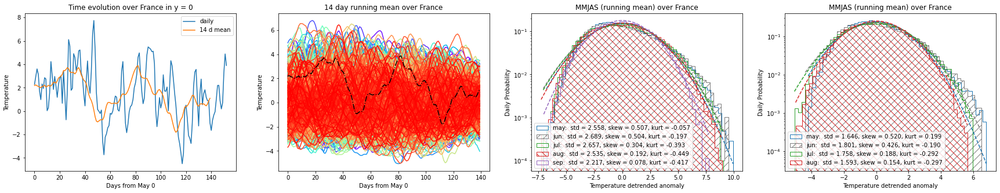

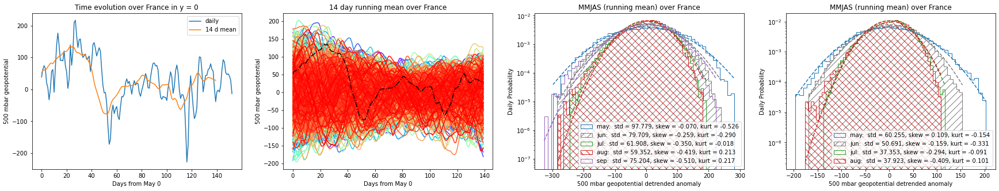

In [8]:
np.save('Postproc/'+Model+'_'+area+'_t2m', t2m.abs_area_int )
convseq = np.ones(14)/14
mycolors = ["tab:blue", "tab:gray", "tab:green", "tab:red", "tab:purple"]   # these colors are used to distinguish the months
monthhatches = ["","//","","\\\\",""]
mymonth = ["may", "jun", "jul", "aug", "sep"]
mylinewidth = [1, 1, 1, 1, 1]    # summer months should be more visible

for myfield in [t2m, zg500]:
    myyear = 0
    PltDistHist(myfield, convseq, mycolors, monthhatches, mymonth, mylinewidth, myyear, Tot_Mon1,area)

A.shape =  (1000, 79)
np.std(A) =  1.747154422916587


../ERA/ERA_Fields.py:792: UserWarning: a_max_and_ti_postproc: adjusting length
  warnings.warn('a_max_and_ti_postproc: adjusting length')


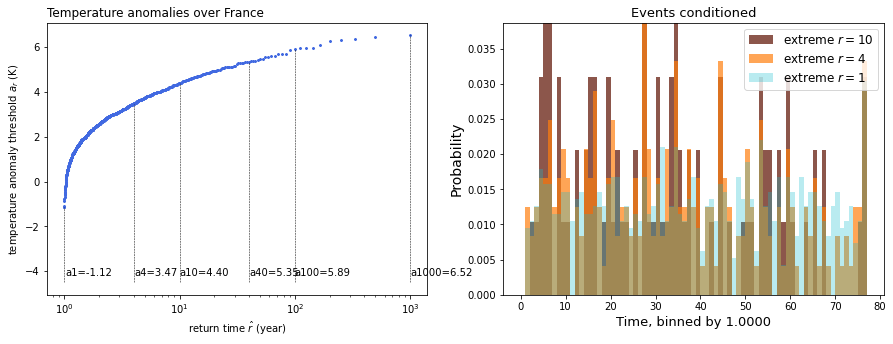

In [9]:
A = np.zeros((1000, Tot_Mon1[9] - Tot_Mon1[6] - 13))   # When we use convolve (running mean) there is an extra point that we can generate by displacing the window hence 13 instead of 14
convseq = np.ones(14)/14
for y in range(1000):
    A[y,:]=np.convolve(t2m.abs_area_int[y,(Tot_Mon1[6]):(Tot_Mon1[9])],  convseq, mode='valid')
print("A.shape = ", A.shape)
print("np.std(A) = ",np.std(A))
A_max, Ti, year_a = a_max_and_ti_postproc(A, A.shape[1])
year_a = range(1000)
A_max_sorted = a_decrese(A_max, Ti, year_a)
XX_rt, YY_rt, xx_rt, yy_rt = return_time_fix(A_max_sorted)

figure = plt.figure(1, figsize=(15, 5))
ax1 = figure.add_subplot(121)
Ax = figure.add_subplot(122)
PltReturnsHist(XX_rt, YY_rt, xx_rt, yy_rt, A_max_sorted, Tot_Mon1,area,ax1,Ax)

A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
[6.522454171423039, 6.450543753248291, 6.378578406205746, 6.3028845929502255, 6.290129063365162, 6.084967587397134, 5.97517194153808, 5.960418774549859, 5.956162307599918, 5.892270434634785, 5.871668983301947, 

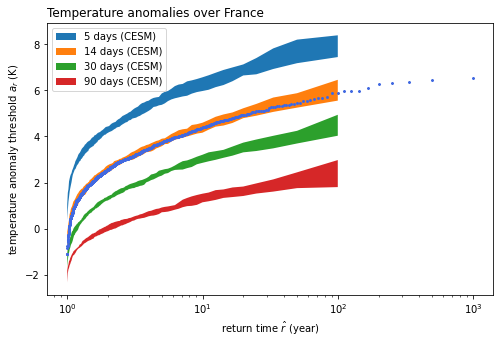

In [10]:
figure = plt.figure(1, figsize=(8, 5))
ax = figure.add_subplot(111)
BootstrapReturnsOnly(t2m.abs_area_int, 'CESM', Tot_Mon1, area, ax,[5,14,30,90])
ax.scatter(XX_rt, YY_rt, s=4, color='royalblue', marker='x')
print(YY_rt)
plt.legend()

A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape =  (1000, 92)
A.shape =  (1000, 88)
A.shape =  (1000, 79)
A.shape =  (1000, 63)


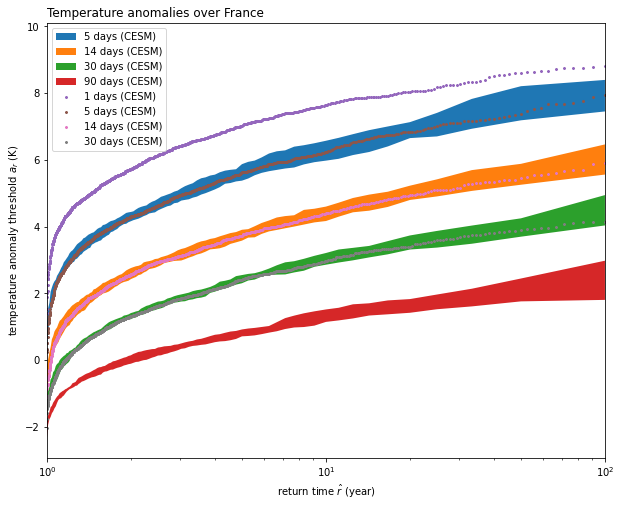

In [11]:
def ReturnsOnly(myseries, TO, Tot_Mon1, area, ax):
    for T in [1,5,14,30]:
        convseq = np.ones(T)/T
        A = np.zeros((1000, Tot_Mon1[9] - Tot_Mon1[6] - T+1))   # When we use convolve (running mean) there is an extra point that we can generate by displacing the window hence 13 instead of 14
        for y in range(1000):
            A[y,:] = np.convolve(myseries[y,Tot_Mon1[6]:(Tot_Mon1[9])],  convseq, mode='valid')
        print("A.shape = ",A.shape)
        A_max, Ti, year_a = a_max_and_ti_postproc(A, A.shape[1])
        A_max_sorted = a_decrese(A_max, Ti, year_a)
        XX_rt, YY_rt, xx_rt, yy_rt = return_time_fix(A_max_sorted)
        np.save('Postproc/'+TO+'_'+area+'_YY_rt_'+str(T),YY_rt)
        ax.scatter(XX_rt, YY_rt, s=4, marker='x',label=str(T)+' days ('+TO+')')
    ax.set_xscale('log')
    ax.set_xlabel('return time $\hat{r}$ (year)')
    ax.set_ylabel('temperature anomaly threshold $a_r$ (K)')
    ax.set_title('Temperature anomalies over '+ area, loc='left')
    ax.set_xlim([1, 100])
figure = plt.figure(1, figsize=(10, 8))
ax = figure.add_subplot(111)
BootstrapReturnsOnly(t2m.abs_area_int, 'CESM', Tot_Mon1, area, ax,[5,14,30,90])
ReturnsOnly(t2m.abs_area_int, 'CESM', Tot_Mon1, area, ax)
plt.legend()

A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 88)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 79)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 63)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)
A.shape = (100, 3)


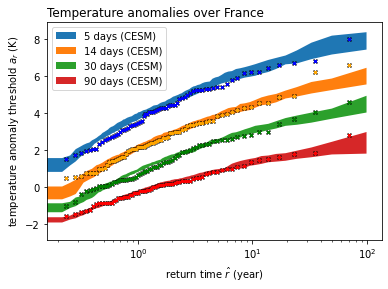

In [33]:
def BootstrapReturns(myseries,FROM, TO, Tot_Mon1,area, ax, Ts, modified='no', read_path='./', write_path='./'):
    # remove extra / from paths
    read_path = read_path.rstrip('/')
    write_path = write_path.rstrip('/')
    
    # Compare bootstrapped method (to be saved in "TO") to the points in "FROM"
    BootstrapReturnsOnly(myseries, TO, Tot_Mon1, area, ax, Ts, modified, write_path=write_path)
    for T, mycolor in zip(Ts,['blue','orange','green','red']):
        ERA_XX_rt = np.load(f'{read_path}/../ERA/Postproc/{FROM}_{area}_XX_rt_{T}.npy')
        ERA_YY_rt = np.load(f'{read_path}/../ERA/Postproc/{FROM}_{area}_YY_rt_{T}.npy')
        plt.scatter(ERA_XX_rt, ERA_YY_rt, s=15, marker='x', color='black')
        plt.scatter(ERA_XX_rt, ERA_YY_rt, s=7, marker='x', color=mycolor)#,label=str(T)+' days ('+FROM+')')
    ax.legend(loc='best')


figure = plt.figure(1, figsize=(6, 4))
ax = figure.add_subplot(111)
BootstrapReturns(t2m.abs_area_int,'ERA','CESM', Tot_Mon1,area, ax,[5,14,30,90],'yes')
ax.set_xlabel('return time $\hat{r}$ (year)')
ax.set_ylabel(r'temperature anomaly threshold $a_r$ (K)')
ax.set_title('')
figure.savefig('Images/Returns_'+Model+'_'+area+'.png',bbox_inches='tight', dpi=200)

(10, 92)
(92,) (92,)


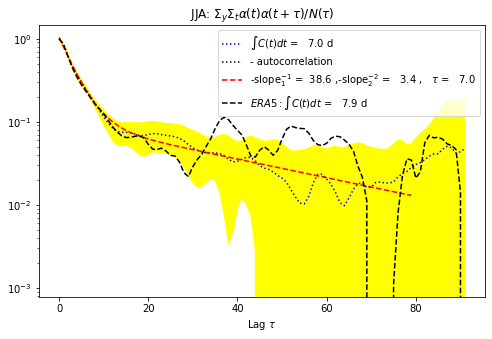

In [13]:
myfirst = [Tot_Mon1[6]]
mylast = [Tot_Mon1[9]]
myperiod_label = ['JJA']
myfiglabels = ['161']

figure = plt.figure(1, figsize=(8, 5))
for first, last, period_label, figlabels in zip(myfirst, mylast, myperiod_label, myfiglabels):
    autocorr = []
    for i in range(10):
        autocorr.append(autocorrelation(t2m.abs_area_int[i*100:(i+1)*100,first:last],last-first))
    autocorr = np.array(autocorr)/np.std(t2m.abs_area_int[i*100:(i+1)*100,first:last])**2
    print(autocorr.shape)
    autocorr_mean = np.mean(autocorr,0)
    autocorr_std = np.std(autocorr,0)
    np.save('Postproc/CESM_'+area+'_autocorr_mean_'+period_label,autocorr_mean)
    np.save('Postproc/CESM_'+area+'_autocorr_std_'+period_label,autocorr_std)
    print(autocorr_mean.shape,autocorr_std.shape)
    plt.fill_between(np.arange(0, len(autocorr_mean)), autocorr_mean-autocorr_std, autocorr_mean+autocorr_std,color='yellow')
    PltAutocorrelationFit(autocorr_mean,autocorr_std,0,80,ax,period_label)    
    autocorr_ERA5 = np.load('../ERA/Postproc/ERA_'+area+'_auto_corr_'+period_label+'.npy')
    plt.plot(np.arange(0, len(autocorr_ERA5)), autocorr_ERA5,'k--', label=r'$ERA5: \int C(t) dt$ = %5.1f d'%(integrate.cumtrapz(np.array(autocorr_ERA5), range(len(autocorr_ERA5)), initial=0)[-1]))
    plt.legend()
    extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    figure.savefig("Images/autocorelation_"+period_label+"_"+area+".png", bbox_inches=extent.expanded(1.3, 1.3))

(10, 92)
(92,) (92,)


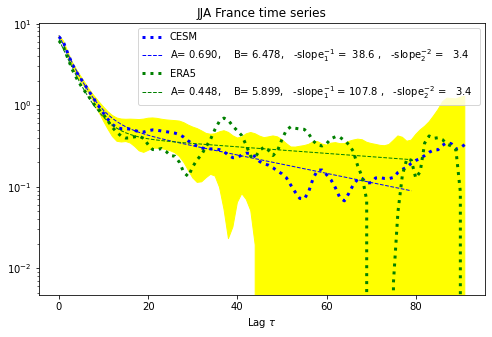

In [14]:
def PltAutocorrelationFit2(autocorr_mean,colors, linewidths, x1,x2, ax, Model):
    # Plot normalized Autocorrelation function
    plt.plot(np.arange(0, len(autocorr_mean)), autocorr_mean,colors[0], linewidth = linewidths[0], label=Model)#r'$\int C(t) dt$ = %5.1f d'%(integrate.cumtrapz(np.array(autocorr_mean), range(len(autocorr_mean)), initial=0)[-1]))
    #plt.plot(np.arange(0, len(autocorr_mean)), -autocorr_mean,'k:', label='- autocorrelation')
    
    popt1, pcov1 = curve_fit(func1, np.array(range(x1,x2)), autocorr_mean[x1:x2], p0=(1, 1e-6, 1, 1e-6))
    xaxis1 = np.arange(x1,x2)
    plt.plot(xaxis1, func1(xaxis1, *popt1), colors[1], linewidth = linewidths[1], label=r'A= %5.3f,$\quad$ B= %5.3f,$\quad$-slope$^{-1}_1$ = %5.1f ,$\quad$-slope$^{-2}_2$ = %5.1f  ' %(popt1[0],popt1[2],-popt1[1]**(-1),-popt1[3]**(-1)))
    plt.yscale("log")
    plt.xlabel(r"Lag $\tau$")



myfirst = [Tot_Mon1[6]]
mylast = [Tot_Mon1[9]]
myperiod_label = ['JJA']
myfiglabels = ['161']

figure = plt.figure(1, figsize=(8, 5))
for first, last, period_label, figlabels in zip(myfirst, mylast, myperiod_label, myfiglabels):
    autocorr = []
    for i in range(10):
        autocorr.append(autocorrelation(t2m.abs_area_int[i*100:(i+1)*100,first:last],last-first))
    autocorr = np.array(autocorr)#/np.std(t2m.abs_area_int[i*100:(i+1)*100,first:last])**2
    print(autocorr.shape)
    autocorr_mean = np.mean(autocorr,0)
    autocorr_std = np.std(autocorr,0)
    np.save('Postproc/Plasim_'+area+'_nonorm_autocorr_mean_'+period_label,autocorr_mean)
    np.save('Postproc/Plasim_'+area+'_nonorm_autocorr_std_'+period_label,autocorr_std)
    print(autocorr_mean.shape,autocorr_std.shape)
    plt.fill_between(np.arange(0, len(autocorr_mean)), autocorr_mean-autocorr_std, autocorr_mean+autocorr_std,color='yellow')
    autocorr_ERA5 = np.load('../ERA/Postproc/ERA_'+area+'_nonorm_auto_corr_'+period_label+'.npy')
    PltAutocorrelationFit2(autocorr_mean,['b:','b--'], [3, 1], 0,80,ax,Model)   
    PltAutocorrelationFit2(autocorr_ERA5,['g:','g--'], [3, 1],0,80,ax,'ERA5')   
    plt.legend()
    plt.title(period_label+" "+area+" time series")
    #extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    figure.savefig("Images/autocorelation_"+period_label+"_"+Model+"_"+area+".png")#, bbox_inches=extent.expanded(1.3, 1.3))

(10, 92)
(92,) (92,)


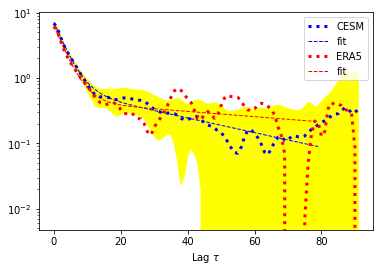

In [37]:
def PltAutocorrelationFit2(autocorr_mean,colors, linewidths, x1,x2, ax, Model):
    # Plot normalized Autocorrelation function
    plt.plot(np.arange(0, len(autocorr_mean)), autocorr_mean,colors[0], linewidth = linewidths[0], label=Model)#r'$\int C(t) dt$ = %5.1f d'%(integrate.cumtrapz(np.array(autocorr_mean), range(len(autocorr_mean)), initial=0)[-1]))
    #plt.plot(np.arange(0, len(autocorr_mean)), -autocorr_mean,'k:', label='- autocorrelation')
    
    popt1, pcov1 = curve_fit(func1, np.array(range(x1,x2)), autocorr_mean[x1:x2], p0=(1, 1e-6, 1, 1e-6))
    xaxis1 = np.arange(x1,x2)
    plt.plot(xaxis1, func1(xaxis1, *popt1), colors[1], linewidth = linewidths[1], label='fit')
    plt.yscale("log")
    plt.xlabel(r"Lag $\tau$")



myfirst = [Tot_Mon1[6]]
mylast = [Tot_Mon1[9]]
myperiod_label = ['JJA']
myfiglabels = ['161']

figure = plt.figure(1, figsize=(6, 4))
for first, last, period_label, figlabels in zip(myfirst, mylast, myperiod_label, myfiglabels):
    autocorr = []
    for i in range(10):
        autocorr.append(autocorrelation(t2m.abs_area_int[i*100:(i+1)*100,first:last],last-first))
    autocorr = np.array(autocorr)#/np.std(t2m.abs_area_int[i*100:(i+1)*100,first:last])**2
    print(autocorr.shape)
    autocorr_mean = np.mean(autocorr,0)
    autocorr_std = np.std(autocorr,0)
    np.save('Postproc/Plasim_'+area+'_nonorm_autocorr_mean_'+period_label,autocorr_mean)
    np.save('Postproc/Plasim_'+area+'_nonorm_autocorr_std_'+period_label,autocorr_std)
    print(autocorr_mean.shape,autocorr_std.shape)
    plt.fill_between(np.arange(0, len(autocorr_mean)), autocorr_mean-autocorr_std, autocorr_mean+autocorr_std,color='yellow')
    autocorr_ERA5 = np.load('../ERA/Postproc/ERA_'+area+'_nonorm_auto_corr_'+period_label+'.npy')
    PltAutocorrelationFit2(autocorr_mean,['b:','b--'], [3, 1], 0,80,ax,Model)   
    PltAutocorrelationFit2(autocorr_ERA5,['r:','r--'], [3, 1],0,80,ax,'ERA5')   
    plt.legend()
    #plt.title(period_label+" "+area+" time series")
    #extent = ax.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
    figure.savefig("Images/autocorelation_"+period_label+"_"+Model+"_"+area+".png",bbox_inches='tight', dpi=200)

In [15]:
return_index = 1
threshold = 3.5
for T in [14]:
    print("threshold = ",yy_rt[return_index], "return = ", xx_rt[return_index])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        #CompComposites(t2m.abs_area_int, myfield, T, Tot_Mon1, 1)
        CompCompositesThreshold(t2m.abs_area_int, myfield, T, Tot_Mon1, threshold)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

threshold =  3.472673762447526 return =  4.0
TSA
A.shape =  (1000, 79)
A_max[0] = 3.8858393606317643, Ti[0] = 51
A_max[3] = 3.5098675685265235, Ti[3] = 32
A_max[8] = 3.6386652995220277, Ti[8] = 78
A_max[11] = 5.096380973039235, Ti[11] = 55
A_max[12] = 3.6240445429974475, Ti[12] = 73
A_max[21] = 4.184617313481229, Ti[21] = 14
A_max[24] = 5.960418774549859, Ti[24] = 36
A_max[25] = 5.956162307599918, Ti[25] = 6
A_max[26] = 4.1996878785764284, Ti[26] = 12
A_max[30] = 3.8180934025300632, Ti[30] = 48
A_max[33] = 5.140320517302282, Ti[33] = 42
A_max[39] = 3.9674724089763758, Ti[39] = 68
A_max[59] = 4.8096884508642095, Ti[59] = 67
A_max[66] = 4.673031044899329, Ti[66] = 9
A_max[68] = 3.996891062439207, Ti[68] = 60
A_max[71] = 3.8929428907270798, Ti[71] = 28
A_max[72] = 4.927700102777299, Ti[72] = 49
A_max[73] = 5.30299920502943, Ti[73] = 34
A_max[74] = 4.098961230786283, Ti[74] = 74
A_max[75] = 3.8312768861498485, Ti[75] = 10
A_max[77] = 6.290129063365162, Ti[77] = 21
A_max[80] = 4.04909881904

../ERA/ERA_Fields.py:792: UserWarning: a_max_and_ti_postproc: adjusting length
  warnings.warn('a_max_and_ti_postproc: adjusting length')


A_max[209] = 4.90482650058837, Ti[209] = 6
A_max[211] = 4.423466323037121, Ti[211] = 53
A_max[215] = 3.557089156877724, Ti[215] = 20
A_max[216] = 3.552250510007223, Ti[216] = 27
A_max[217] = 3.7085806924062874, Ti[217] = 66
A_max[220] = 5.372095192724298, Ti[220] = 20
A_max[226] = 4.408611784940353, Ti[226] = 67
A_max[230] = 6.084967587397134, Ti[230] = 18
A_max[235] = 5.6714174539487265, Ti[235] = 4
A_max[239] = 4.607004616881273, Ti[239] = 35
A_max[250] = 4.187553267500795, Ti[250] = 40
A_max[251] = 3.723063975440065, Ti[251] = 67
A_max[254] = 4.77959709007517, Ti[254] = 37
A_max[258] = 3.7234069409649044, Ti[258] = 27
A_max[259] = 3.69508426764328, Ti[259] = 26
A_max[265] = 4.1332808761683735, Ti[265] = 36
A_max[268] = 3.6098817194726367, Ti[268] = 15
A_max[271] = 3.6370535710896155, Ti[271] = 19
A_max[275] = 4.507094128211611, Ti[275] = 8
A_max[278] = 5.092789798380467, Ti[278] = 39
A_max[286] = 5.452935299663697, Ti[286] = 19
A_max[289] = 4.470608683758118, Ti[289] = 21
A_max[298]

/tmp/ipykernel_3937152/3845430226.py:14: MatplotlibDeprecationWarning: 
The dedent function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use inspect.cleandoc instead.
  m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')


0


../ERA/ERA_Fields.py:623: UserWarning: No contour levels were found within the data range.
  c_sign = m.contour(Lon, Lat, zg_sign, levels=data_contour_level[:data_contour_level.shape[0]//2], colors=colors[0], linestyles = mylinestyles[0],linewidths=mylinewidths[0], latlon=True)  #negative significant anomalies of geopotential


1
2
3
4


../ERA/ERA_Fields.py:624: UserWarning: No contour levels were found within the data range.
  c_sign = m.contour(Lon, Lat, zg_sign, levels=data_contour_level[data_contour_level.shape[0]//2:], colors=colors[3], linestyles = mylinestyles[3],linewidths=mylinewidths[3], latlon=True)   #positive significant anomalies of geopotential


5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59


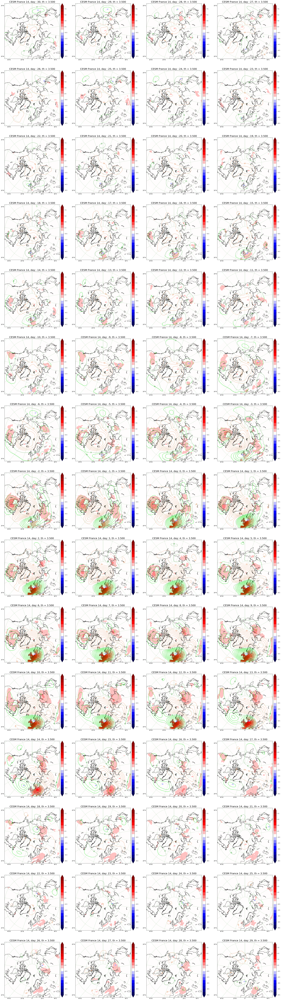

In [16]:
t_value = 2
ts_level = np.linspace(-8.5, 8.5, 18) 
zg_level = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10)))
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

import matplotlib.gridspec as gridspec
fig2 = plt.figure(figsize=(40, 150))

spec2 = gridspec.GridSpec(ncols=4, nrows=15, figure=fig2)
Nb_frame = 60
for j in range(15):
    for i in range(4):
        ax = fig2.add_subplot(spec2[j,i])
        m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
        myindex = (i+4*j)
        title_frame = Model+" "+area+" "+str(T)
        print(myindex)
        if myindex < Nb_frame:
            temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
            geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', th = %1.3f'%(threshold)) #r = %1.3f'%(xx_rt[return_index]))
            geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
            PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
            #fig2.savefig("Images/"+Model+"_north_"+area+"_"+str(T)+"_"+str(xx_rt[return_index])+"_"+str((i+4*j)-30)+".png", bbox_inches=full_extent(ax,.25).transformed(fig2.dpi_scale_trans.inverted()))
            fig2.savefig("Images/"+Model+"_north_"+area+"_"+str(T)+"_"+str(threshold)+"_"+str((i+4*j)-30)+".png", bbox_inches=full_extent(ax,.25).transformed(fig2.dpi_scale_trans.inverted()))
#fig2.savefig("Images/CESM_"+area+"_composites.png")

In [17]:
plasim_t2m_composite_mean = np.load('../PLASIM/Postproc/France_tas_composite_mean_14.npy')
plasim_t2m_composite_std = np.load('../PLASIM/Postproc/France_tas_composite_std_14.npy')
plasim_t2m_composite_t = np.load('../PLASIM/Postproc/France_tas_composite_t_14.npy')
plasim_zg500_composite_mean = np.load('../PLASIM/Postproc/France_zg_composite_mean_14.npy')
plasim_zg500_composite_std = np.load('../PLASIM/Postproc/France_zg_composite_std_14.npy')
plasim_zg500_composite_t = np.load('../PLASIM/Postproc/France_zg_composite_t_14.npy')
plasim_LAT = np.load('../PLASIM/Postproc/LAT.npy')
plasim_LON = np.load('../PLASIM/Postproc/LON.npy')

ERA_t2m_composite_mean = np.load('../ERA/Postproc/France_t2m_composite_mean_14.npy')
ERA_t2m_composite_std = np.load('../ERA/Postproc/France_t2m_composite_std_14.npy')
ERA_t2m_composite_t = np.load('../ERA/Postproc/France_t2m_composite_t_14.npy')
ERA_zg500_composite_mean = np.load('../ERA/Postproc/France_z_composite_mean_14.npy')
ERA_zg500_composite_std = np.load('../ERA/Postproc/France_z_composite_std_14.npy')
ERA_zg500_composite_t = np.load('../ERA/Postproc/France_z_composite_t_14.npy')
ERA_LAT = np.load('../ERA/Postproc/LAT.npy')
ERA_LON = np.load('../ERA/Postproc/LON.npy')

50
51
52
53
54


/usr/lib/python3/dist-packages/matplotlib/contour.py:1243: UserWarning: No contour levels were found within the data range.
  warnings.warn("No contour levels were found"


55
56
57
58
59


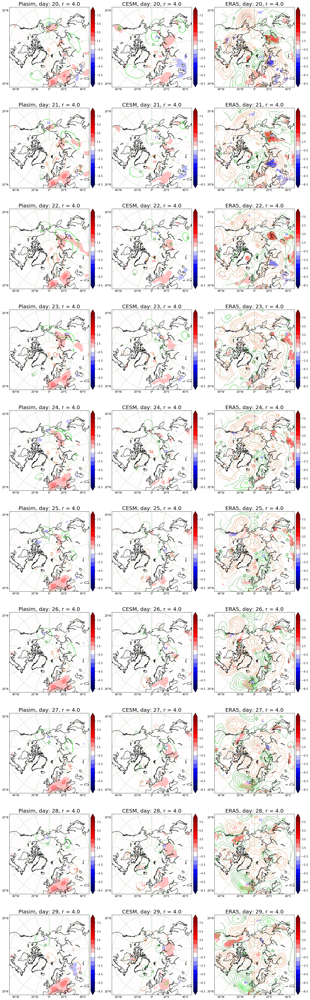

In [20]:
t_value = 2
ts_level = np.linspace(-8.5, 8.5, 18) 
zg_level = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10)))
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

import matplotlib.gridspec as gridspec
fig2 = plt.figure(figsize=(20, 70))

spec2 = gridspec.GridSpec(ncols=3, nrows=10, figure=fig2)
Nb_frame = 60
for j in range(10):
    ax = fig2.add_subplot(spec2[j,1])
    m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
    myindex = j+50
    print(myindex)
    title_frame = "CESM"
    temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
    geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = ' + str(xx_rt[return_index]))
    geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
    PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
    title_frame = "Plasim"
    ax = fig2.add_subplot(spec2[j,0])
    m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
    temp_sign, ts_taken = significative_data(plasim_t2m_composite_mean[myindex,:,:], plasim_t2m_composite_t[myindex,:,:], t_value, False)
    geo_contourf(m, ax, 0, Greenwich(plasim_LON), Greenwich(plasim_LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = ' + str(xx_rt[return_index]))
    geo_contour_color(m, ax, 0, Greenwich(plasim_LON), Greenwich(plasim_LAT), t_value, Greenwich(plasim_zg500_composite_mean[myindex,:,:]), Greenwich(plasim_zg500_composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
    PltMaxMinValue(m,Greenwich(plasim_LON), Greenwich(plasim_LAT), Greenwich(plasim_zg500_composite_mean[myindex,:,:]))
    title_frame = "ERA5"
    ax = fig2.add_subplot(spec2[j,2])
    m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
    temp_sign, ts_taken = significative_data(ERA_t2m_composite_mean[myindex,:,:], ERA_t2m_composite_t[myindex,:,:], t_value, False)
    geo_contourf(m, ax, 0, Greenwich(ERA_LON), Greenwich(ERA_LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = ' + str(xx_rt[return_index]))
    geo_contour_color(m, ax, 0, Greenwich(ERA_LON), Greenwich(ERA_LAT), t_value, Greenwich(ERA_zg500_composite_mean[myindex,:,:]), Greenwich(ERA_zg500_composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
    PltMaxMinValue(m,Greenwich(ERA_LON), Greenwich(ERA_LAT), Greenwich(ERA_zg500_composite_mean[myindex,:,:]))
            #fig2.savefig("Images/north_"+area+"_"+str(T)+"_"+str(xx_rt[4])+"_"+str(3*(i+3*j)-30)+".png", bbox_inches=full_extent(ax,.25).transformed(fig2.dpi_scale_trans.inverted()))
fig2.savefig("Images/Intermodel_composites6.png")

In [18]:
return_index = 4
for T in [14]:
    print("threshold = ",yy_rt[return_index], "return = ", xx_rt[return_index])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompComposites(t2m.abs_area_int, myfield, T, Tot_Mon1, return_index)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

threshold =  5.892270434634785 return =  100.0
TSA


TypeError: CompComposites() missing 1 required positional argument: 'modified'

30


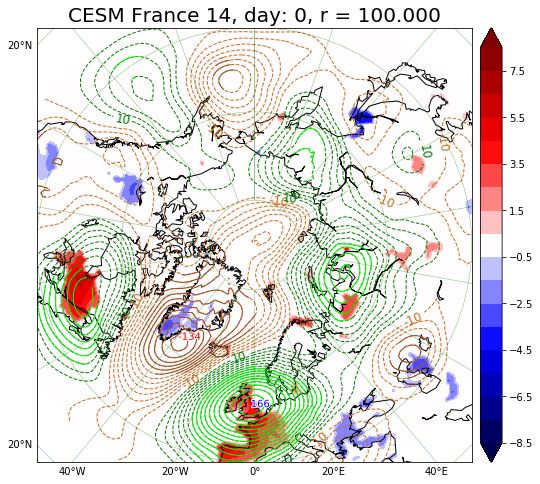

In [22]:
t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

fig2 = plt.figure(figsize=(10, 8))

ax = fig2.add_subplot(1, 1, 1)
m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
myindex = 30
title_frame = Model+" "+area+" "+str(T)
print(myindex)
temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = %1.3f'%(xx_rt[return_index]))
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
fig2.savefig("Images/CESM_"+area+"_composites"+str(T)+"_"+str(xx_rt[return_index])+"_"+str(myindex-30)+".png")

In [23]:
return_index = [1,4]
for T in [14]:
    print("threshold = ",yy_rt[return_index[0]],yy_rt[return_index[1]], "return = ", xx_rt[return_index[0]], xx_rt[return_index[1]])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompCompositesBetween(t2m.abs_area_int, myfield, T, Tot_Mon1, return_index)

threshold =  3.472673762447526 5.892270434634785 return =  4.0 100.0
TSA
A.shape =  (1000, 79)
[1.0, 4.0, 10.0, 40.0, 100.0, 1000.0] [-1.1246655814461881, 3.472673762447526, 4.379918169095536, 5.347503971345052, 5.892270434634785, 6.522454171423039]
A_max[0] =  3.8858393606317643 Ti[0] =  50
A_max[3] =  3.5098675685265235 Ti[3] =  31
A_max[8] =  3.62334986327717 Ti[8] =  76
A_max[11] =  5.096380973039235 Ti[11] =  54
A_max[12] =  3.6240445429974475 Ti[12] =  72
A_max[21] =  4.184617313481229 Ti[21] =  13
A_max[26] =  4.1996878785764284 Ti[26] =  11
A_max[30] =  3.8180934025300632 Ti[30] =  47
A_max[33] =  5.140320517302282 Ti[33] =  41
A_max[39] =  3.9674724089763758 Ti[39] =  67
A_max[59] =  4.8096884508642095 Ti[59] =  66
A_max[66] =  4.673031044899329 Ti[66] =  8
A_max[68] =  3.996891062439207 Ti[68] =  59
A_max[71] =  3.8929428907270798 Ti[71] =  27
A_max[72] =  4.927700102777299 Ti[72] =  48
A_max[73] =  5.30299920502943 Ti[73] =  33
A_max[74] =  4.098961230786283 Ti[74] =  73
A_m

30


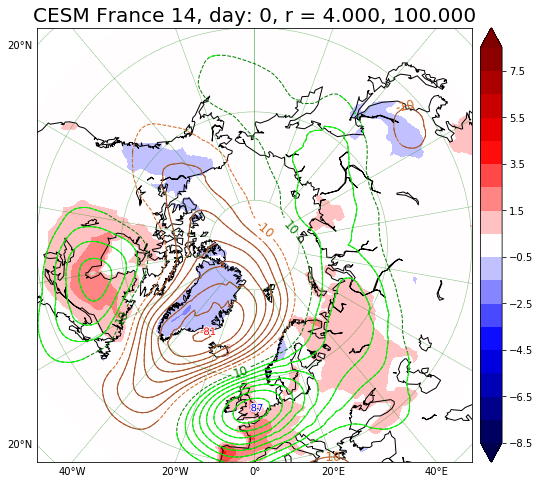

In [24]:
t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

fig2 = plt.figure(figsize=(10, 8))

ax = fig2.add_subplot(1, 1, 1)
m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
myindex = 30
title_frame = Model+" "+area+" "+str(T)
print(myindex)
temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = %1.3f, %1.3f'%(xx_rt[return_index[0]],xx_rt[return_index[1]]))
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
fig2.savefig("Images/CESM_"+area+"_composites"+str(T)+"_"+str(xx_rt[return_index[0]])+"_"+str(xx_rt[return_index[1]])+"_"+str(myindex-30)+".png")

threshold =  4.379918169095536 return =  10.0
TSA
A.shape =  (1000, 79)
[1.0, 4.0, 10.0, 40.0, 100.0, 1000.0] [-1.1246655814461881, 3.472673762447526, 4.379918169095536, 5.347503971345052, 5.892270434634785, 6.522454171423039]
A_max[11] =  5.096380973039235 Ti[11] =  54
A_max[24] =  5.960418774549859 Ti[24] =  35
A_max[25] =  5.956162307599918 Ti[25] =  5
A_max[33] =  5.140320517302282 Ti[33] =  41
A_max[59] =  4.8096884508642095 Ti[59] =  66
A_max[66] =  4.673031044899329 Ti[66] =  8
A_max[72] =  4.927700102777299 Ti[72] =  48
A_max[73] =  5.30299920502943 Ti[73] =  33
A_max[77] =  6.290129063365162 Ti[77] =  20
A_max[119] =  5.291857076434057 Ti[119] =  58
A_max[122] =  4.632729796460795 Ti[122] =  26
A_max[123] =  6.378578406205746 Ti[123] =  18
A_max[135] =  4.586992716824735 Ti[135] =  29
A_max[151] =  4.899188415767503 Ti[151] =  9
A_max[158] =  4.978437558375341 Ti[158] =  54
A_max[162] =  4.627149101907932 Ti[162] =  76
A_max[164] =  5.011478811470796 Ti[164] =  26
A_max[182] =

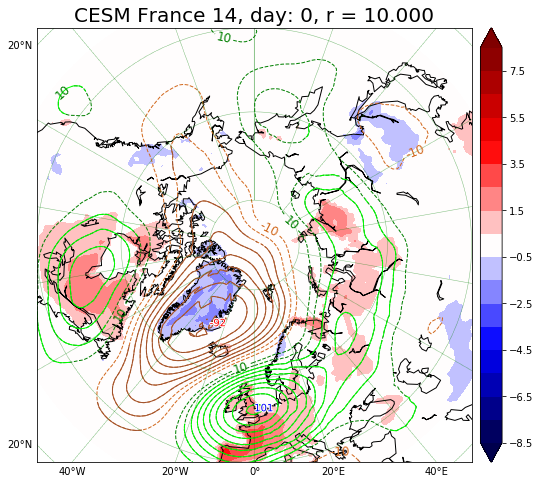

In [25]:
return_index = 2
for T in [14]:
    print("threshold = ",yy_rt[return_index], "return = ", xx_rt[return_index])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompComposites(t2m.abs_area_int, myfield, T, Tot_Mon1, return_index)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

fig2 = plt.figure(figsize=(10, 8))

ax = fig2.add_subplot(1, 1, 1)
m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
myindex = 30
title_frame = Model+" "+area+" "+str(T)
print(myindex)
temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = %1.3f'%(xx_rt[return_index]))
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
fig2.savefig("Images/CESM_"+area+"_composites"+str(T)+"_"+str(xx_rt[return_index])+"_"+str(myindex-30)+".png")

threshold =  4.379918169095536 return =  10.0
TSA
A.shape =  (1000, 88)
[1.0, 4.0, 10.0, 40.0, 100.0, 1000.0] [0.09968690380336992, 5.297420024482578, 6.231822651530535, 7.23383440166713, 7.953814540375607, 8.872267855554536]
A_max[24] =  8.298036669964603 Ti[24] =  36
A_max[25] =  6.720979802096509 Ti[25] =  12
A_max[33] =  6.897164204590365 Ti[33] =  69
A_max[66] =  7.066519159637831 Ti[66] =  16
A_max[72] =  6.488676722158461 Ti[72] =  25
A_max[73] =  7.1522185573217305 Ti[73] =  33
A_max[74] =  7.7579766745269865 Ti[74] =  15
A_max[77] =  8.151323783116734 Ti[77] =  28
A_max[122] =  6.730073516598847 Ti[122] =  27
A_max[123] =  7.674082048284825 Ti[123] =  22
A_max[164] =  7.23383440166713 Ti[164] =  30
A_max[180] =  7.1870327057254375 Ti[180] =  7
A_max[182] =  6.438636292477957 Ti[182] =  38
A_max[190] =  6.924374977118306 Ti[190] =  12
A_max[201] =  8.626495857178494 Ti[201] =  24
A_max[203] =  6.829921548620398 Ti[203] =  56
A_max[205] =  6.231822651530535 Ti[205] =  54
A_max[2

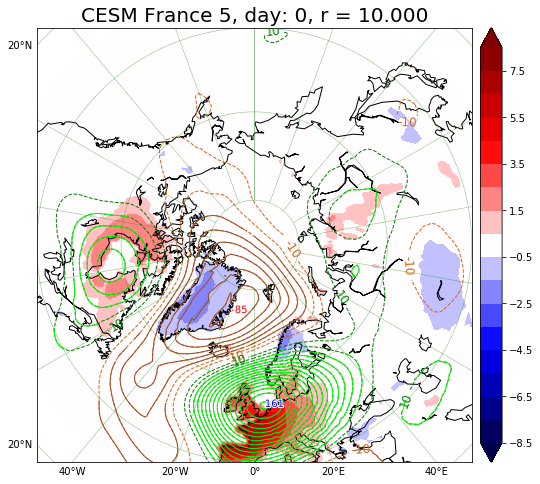

In [26]:
return_index = 2
for T in [5]:
    print("threshold = ",yy_rt[return_index], "return = ", xx_rt[return_index])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompComposites(t2m.abs_area_int, myfield, T, Tot_Mon1, return_index)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

fig2 = plt.figure(figsize=(10, 8))

ax = fig2.add_subplot(1, 1, 1)
m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
myindex = 30
title_frame = Model+" "+area+" "+str(T)
print(myindex)
temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = %1.3f'%(xx_rt[return_index]))
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
fig2.savefig("Images/CESM_"+area+"_composites"+str(T)+"_"+str(xx_rt[return_index])+"_"+str(myindex-30)+".png")

threshold =  4.379918169095536 return =  10.0
TSA
A.shape =  (1000, 92)
[1.0, 4.0, 10.0, 40.0, 100.0, 1000.0] [1.413482866636742, 6.74888108569711, 7.647658233743102, 8.518301185950358, 8.810632969304553, 9.51089250923456]
A_max[0] =  7.745899122060562 Ti[0] =  15
A_max[8] =  8.251138595715156 Ti[8] =  61
A_max[24] =  9.04384530566634 Ti[24] =  39
A_max[33] =  7.970792028379175 Ti[33] =  51
A_max[41] =  7.990363628225787 Ti[41] =  12
A_max[66] =  8.063187427609083 Ti[66] =  17
A_max[73] =  8.616005245213355 Ti[73] =  35
A_max[74] =  8.494236049037532 Ti[74] =  16
A_max[77] =  8.580517779808732 Ti[77] =  31
A_max[89] =  7.880460161690053 Ti[89] =  47
A_max[105] =  7.740107024312502 Ti[105] =  62
A_max[123] =  8.190063108500112 Ti[123] =  25
A_max[168] =  8.046843025677758 Ti[168] =  14
A_max[179] =  7.8261438670562145 Ti[179] =  29
A_max[180] =  7.721108961313319 Ti[180] =  9
A_max[190] =  8.315035847409888 Ti[190] =  15
A_max[201] =  9.51089250923456 Ti[201] =  27
A_max[203] =  8.54973

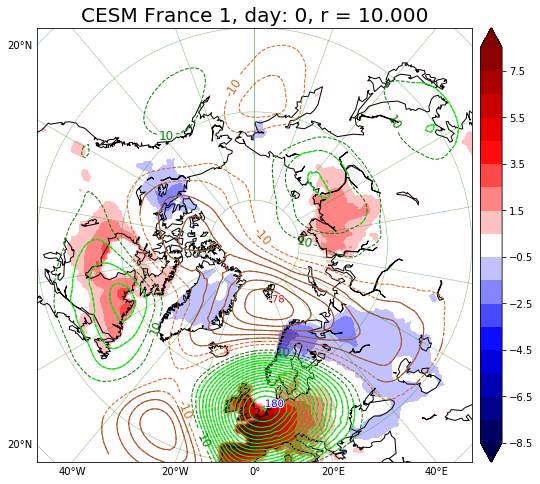

In [27]:
return_index = 2
for T in [1]:
    print("threshold = ",yy_rt[return_index], "return = ", xx_rt[return_index])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompComposites(t2m.abs_area_int, myfield, T, Tot_Mon1, return_index)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

fig2 = plt.figure(figsize=(10, 8))

ax = fig2.add_subplot(1, 1, 1)
m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
myindex = 30
title_frame = Model+" "+area+" "+str(T)
print(myindex)
temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = %1.3f'%(xx_rt[return_index]))
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
fig2.savefig("Images/CESM_"+area+"_composites"+str(T)+"_"+str(xx_rt[return_index])+"_"+str(myindex-30)+".png")

threshold =  4.379918169095536 return =  10.0
TSA
A.shape =  (1000, 63)
[1.0, 4.0, 10.0, 40.0, 100.0, 1000.0] [-2.7123458655739303, 2.120642379079787, 2.9641544298142524, 3.818738346281209, 4.1422181134138, 5.142841793995066]
A_max[8] =  3.0880083068317563 Ti[8] =  60
A_max[11] =  3.2376705151317413 Ti[11] =  45
A_max[24] =  4.812786007982511 Ti[24] =  32
A_max[25] =  3.818738346281209 Ti[25] =  4
A_max[26] =  3.111752099974269 Ti[26] =  4
A_max[33] =  3.8776305872936576 Ti[33] =  45
A_max[59] =  3.7365335358497944 Ti[59] =  57
A_max[68] =  3.3887452225206682 Ti[68] =  54
A_max[72] =  3.2095945682844214 Ti[72] =  0
A_max[73] =  4.081910292186921 Ti[73] =  12
A_max[75] =  3.2803265786763105 Ti[75] =  11
A_max[77] =  3.957583904963183 Ti[77] =  11
A_max[80] =  2.98870771568068 Ti[80] =  27
A_max[89] =  3.3443645335686343 Ti[89] =  19
A_max[99] =  3.315541883579975 Ti[99] =  17
A_max[119] =  3.3231472947364207 Ti[119] =  42
A_max[123] =  3.919601213294562 Ti[123] =  16
A_max[135] =  4.110

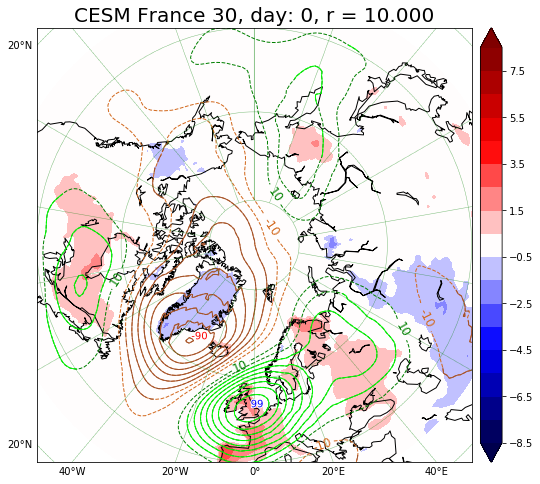

In [28]:
return_index = 2
for T in [30]:
    print("threshold = ",yy_rt[return_index], "return = ", xx_rt[return_index])
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompComposites(t2m.abs_area_int, myfield, T, Tot_Mon1, return_index)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_mean_'+str(T),myfield.composite_mean)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_std_'+str(T),myfield.composite_std)
        np.save('Postproc/'+area+'_'+myfield.name+'_composite_t_'+str(T),myfield.composite_t)

t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

fig2 = plt.figure(figsize=(10, 8))

ax = fig2.add_subplot(1, 1, 1)
m = Basemap(projection='nplaea',boundinglat=40,lon_0=0,resolution='c')
myindex = 30
title_frame = Model+" "+area+" "+str(T)
print(myindex)
temp_sign, ts_taken = significative_data(t2m.composite_mean[myindex,:,:], t2m.composite_t[myindex,:,:], t_value, False)
geo_contourf(m, ax, 0, Greenwich(LON), Greenwich(LAT), Greenwich(temp_sign), ts_level, "seismic", title_frame + ', day: ' + str((myindex - Nb_frame//2))+ ', r = %1.3f'%(xx_rt[return_index]))
geo_contour_color(m, ax, 0, Greenwich(LON), Greenwich(LAT), t_value, Greenwich(zg500.composite_mean[myindex,:,:]), Greenwich(zg500.composite_t[myindex,:,:]), zg_level, ["sienna","chocolate","green","lime"],["solid","dashed","dashed","solid"],[1,1,1,1])
PltMaxMinValue(m,Greenwich(LON), Greenwich(LAT), Greenwich(zg500.composite_mean[myindex,:,:]))
fig2.savefig("Images/CESM_"+area+"_composites"+str(T)+"_"+str(xx_rt[return_index])+"_"+str(myindex-30)+".png")

threshold =  3.5
TSA
A.shape =  (1000, 63)
A_max[24] =  4.812786007982511 Ti[24] =  32
A_max[25] =  3.818738346281209 Ti[25] =  4
A_max[33] =  3.8776305872936576 Ti[33] =  45
A_max[59] =  3.7365335358497944 Ti[59] =  57
A_max[73] =  4.081910292186921 Ti[73] =  12
A_max[77] =  3.957583904963183 Ti[77] =  11
A_max[123] =  3.919601213294562 Ti[123] =  16
A_max[135] =  4.1106139002167215 Ti[135] =  19
A_max[151] =  3.5836691878540154 Ti[151] =  6
A_max[182] =  3.902975052076876 Ti[182] =  28
A_max[189] =  3.749171675364937 Ti[189] =  21
A_max[211] =  3.6762183727836497 Ti[211] =  35
A_max[220] =  4.935128415390058 Ti[220] =  20
A_max[230] =  3.834015848891256 Ti[230] =  17
A_max[239] =  3.7676395749651572 Ti[239] =  19
A_max[289] =  3.9759479563805193 Ti[289] =  19
A_max[302] =  4.348856987107189 Ti[302] =  16
A_max[344] =  3.7186191433026683 Ti[344] =  22
A_max[353] =  3.514457611762081 Ti[353] =  41
A_max[370] =  3.6604549420569903 Ti[370] =  4
A_max[394] =  3.532146309741793 Ti[394] =  

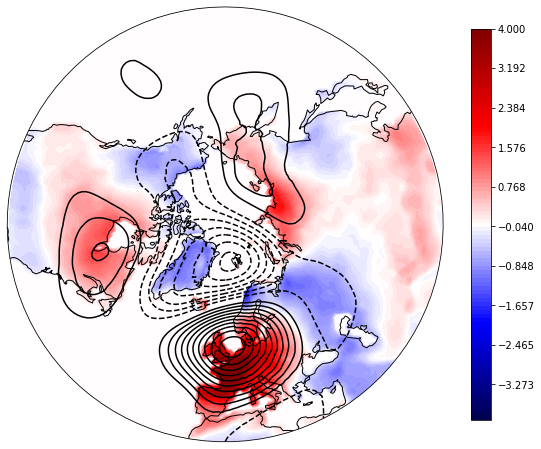

In [32]:
#!/usr/bin/env python3.7

#import sys
#from shutil import copy
#import numpy as np
#import math
#from netCDF4 import Dataset
#import subprocess
#import matplotlib.pyplot as plt
#from matplotlib import cm
#import matplotlib.ticker as mticker
#import pickle
import cartopy.crs as ccrs
from cartopy.util import add_cyclic_point
import matplotlib.path as mpath

def CompExtremes(series, T, Tot_Mon1, threshold):
    # Computes composites conditioned to extremes of field of duration T based on months provided in Tot_Mon1, the return_index is the index of the return times
    convseq = np.ones(T)/T
    A = np.zeros((series.shape[0], Tot_Mon1[9] - Tot_Mon1[6] - T+1))   # When we use convolve (running mean) there is an extra point that we can generate by displacing the window hence 13 instead of 14
    for y in range(series.shape[0]):
        A[y,:]=np.convolve(series[y,Tot_Mon1[6]:(Tot_Mon1[9])],  convseq, mode='valid')
    print("A.shape = ",A.shape)
    return a_max_and_ti_postproc(A, A.shape[1])

def CompCompositesThreshold(series, myfield, T, Tot_Mon1, threshold):
    A_max, Ti, year_a = CompExtremes(series, T, Tot_Mon1, threshold)
    
    tau = np.arange(-30,30,1)
    nb_events = 0
    myfield.composite_mean = np.zeros((len(tau),myfield.var.shape[2],myfield.var.shape[3]))
    myfield.composite_std = np.zeros((len(tau),myfield.var.shape[2],myfield.var.shape[3]))
    for y in range(series.shape[0]):
        if A_max[y] >= threshold:
            print("A_max["+str(y)+"] = ",A_max[y], "Ti["+str(y)+"] = ", Ti[y])
            nb_events += 1
            value = (myfield.var[y])[tau + (Tot_Mon1[6] + Ti[y]) ]
            myfield.composite_mean += value     # This is the raw sum
            myfield.composite_std += value**2   # This is the raw square sum
    print("number of events: ",nb_events)
    # std and mean are computed below
    myfield.composite_std = np.sqrt((myfield.composite_std - (myfield.composite_mean * myfield.composite_mean / nb_events)) / (nb_events - 1))
    myfield.composite_mean /= nb_events
    myfield.composite_t = (lambda a, b: np.divide(a, b, out=np.zeros(a.shape), where=b != 0))(np.sqrt(nb_events) * myfield.composite_mean, myfield.composite_std)
    
ts_level = np.linspace(-4, 4, 100)
zg_level = np.concatenate((np.arange(-10 * 20, 0, 10), np.arange(10, 10 * 21, 10))) 
threshold = 3.5
for T in [30]:
    print("threshold = ",threshold)
    for myfield in [t2m, zg500]:
        print(myfield.name)
        CompCompositesThreshold(t2m.abs_area_int, myfield, T, Tot_Mon1, threshold)
t_value = 2
title_frame = area + '_T' + str(T) + '_' + t2m.filename + '_' + zg500.filename

t2mlevels = np.linspace(-4, 4, 100)

for myfield in [t2m, zg500]:
    myfield.temp = np.mean(myfield.composite_mean[range(30,60),:,:],0)
    
#data=ncfile
#datacm=data to be plotted in color map
#datacl=data to be plotted in contour lines

nlon=288
lon = LON[0,:]
lat = LAT[:,0]
datacm_cyclic, lon_cyclic = add_cyclic_point(t2m.temp, coord=lon)
datacl_cyclic, lon_cyclic = add_cyclic_point(zg500.temp, coord=lon)
lons = LON
lats = LAT
lons_cyclic, lats_cyclic = np.meshgrid(lon_cyclic,lat)

#lons=np.concatenate((lons[:,int(nlon/2):nlon+1]-360.0,lons[:,0:int(nlon/2)]),axis=1)
#lats=np.concatenate((lats[:,int(nlon/2):nlon+1],lats[:,0:int(nlon/2)]),axis=1)

fig=plt.figure(figsize=(10, 8))
ax = plt.axes(projection=ccrs.NorthPolarStereo())
theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)
ax.set_boundary(circle, transform=ax.transAxes)

plt.contourf(lons_cyclic, lats_cyclic, np.clip(datacm_cyclic, -4, 4), levels=ts_level,cmap='seismic',transform=ccrs.PlateCarree())
cb=plt.colorbar(ax=ax,shrink=0.9); cb.ax.tick_params(labelsize=10) #cb.ax.tick_params(labelsize='smaller')
plt.contour(lons_cyclic, lats_cyclic, datacl_cyclic, levels=zg_level,colors='k',linewidths=1.5,transform=ccrs.PlateCarree())
ax.set_extent([-180, 180, 30, 90], crs=ccrs.PlateCarree())
ax.coastlines(linewidth=1)

fig.savefig("Images/"+area+"_3.5.png", bbox_inches='tight') 